In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


In [2]:
import matplotlib.pyplot as plt

%matplotlib inline

In [3]:
data_path = "../TabulaSapiensData/"

In [4]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9002. The TBB threading layer is disabled.
  warnings.warn(problem)
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


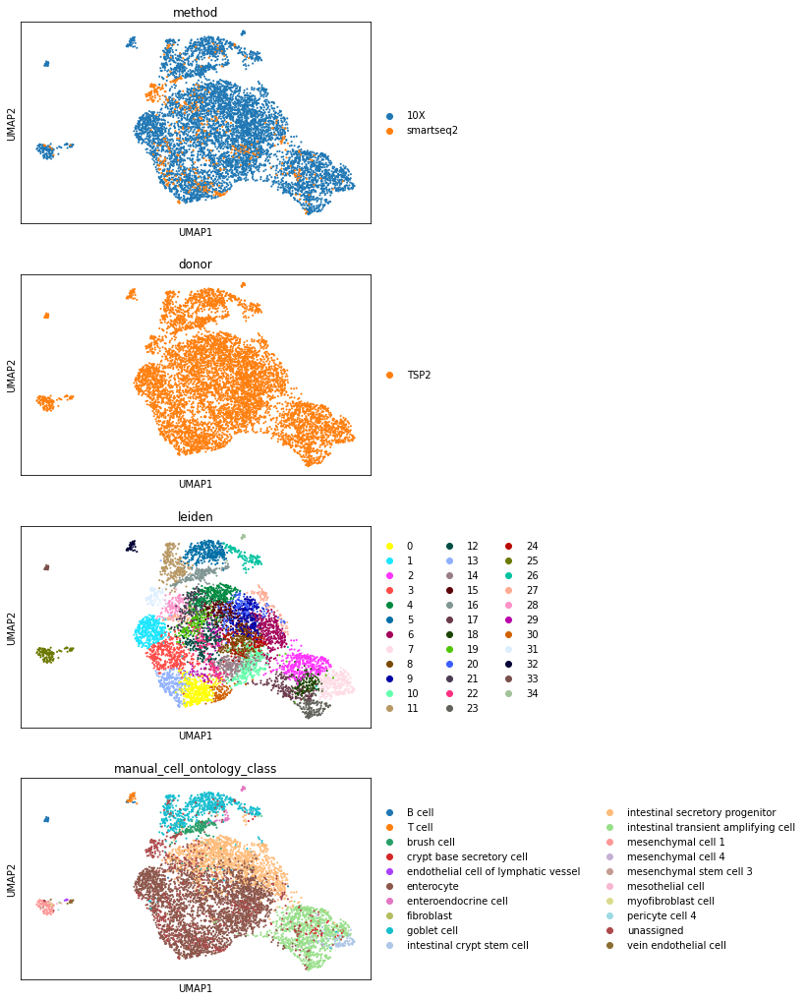

In [5]:
organ = "Large_Intestine"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [6]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

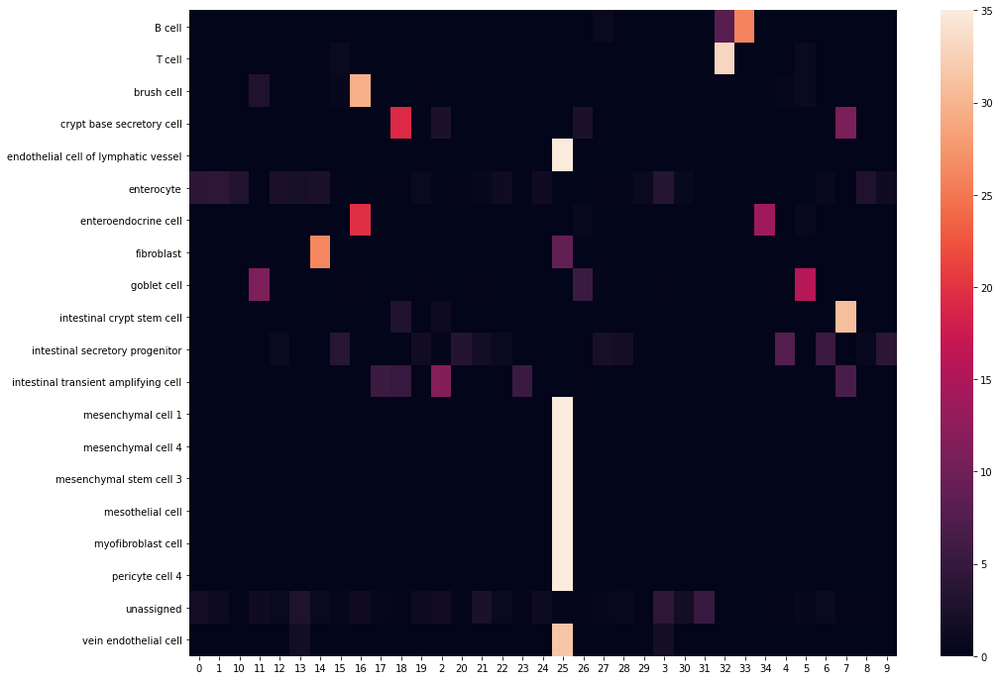

In [7]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.mean(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [8]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

In [9]:
cluster_composition["0"]

['enterocyte: 0.92', 'goblet cell: 0.00', 'unassigned: 0.08']

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [10]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

In [11]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-1-963029a66ab7>:5: RuntimeWarning: invalid value encountered in long_scalars
  return (np.max(x) / np.sum(x), names[np.argmax(x)])


In [12]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


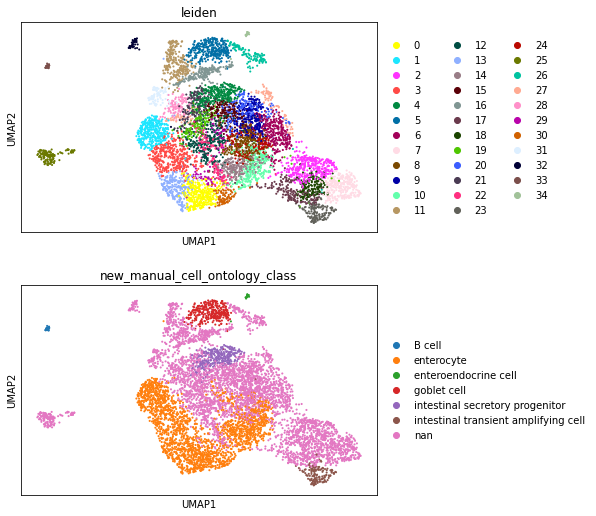

In [13]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

# Sankey Diagram between cluster and cell types

In [14]:
from utils.colorDict import donor_colors, method_colors, compartment_colors, tissue_colors

In [15]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

In [16]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Large_Intestine.html'

# visualize compartment markers

In [17]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

In [18]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



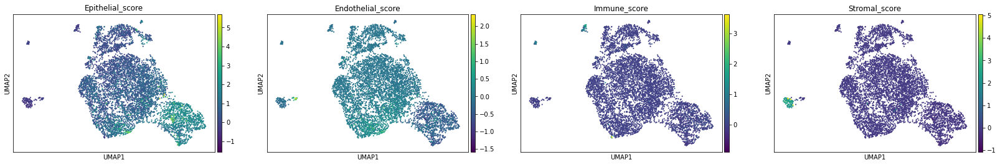

In [19]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [20]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

In [21]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


In [22]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

### top positive marker genes

In [23]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
CLCA4,28.993553,5.909590,4.670614e-180
GUCA2A,27.530579,4.781933,2.225394e-162
CEACAM7,25.116819,4.037109,6.393121e-135
SELENOP,24.816887,3.575540,8.672602e-132
IL32,24.631992,3.810050,6.757882e-130
CA4,24.270613,3.829966,3.931320e-126
SLC26A3,23.155916,3.136446,1.065850e-114
TMIGD1,22.568306,3.852168,6.533227e-109
MUC12,22.253582,2.675831,6.811488e-106
MYO15B,22.006603,3.315357,1.465616e-103


1


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND3,22.068512,1.531659,9.337632e-104
MT-CO2,21.956396,1.467793,8.857956e-103
MT-CO3,21.189758,1.401123,1.164693e-95
MT-CYB,21.082378,1.319771,9.708005e-95
MTND1P23,20.412506,1.405339,8.468822e-89
MT-ATP6,20.025820,1.342412,1.931328e-85
MT-CO1,19.192579,1.226549,2.094375e-78
MT-ND1,17.539295,1.109582,2.486798e-65
MT-ND4,17.492409,1.078245,5.353547e-65
MTATP6P1,17.405016,1.207604,2.224814e-64


2


,wilcoxon_score,log fold change,adjusted pvalue
CD24,29.545231,5.454875,4.451857e-187
PIGR,29.411619,4.854922,1.148158e-185
HSPA5,29.234938,4.745782,1.353865e-183
KLF6,29.225500,5.318802,1.353865e-183
CYCS,29.142458,4.907643,1.225718e-182
LGALS4,29.110495,6.036372,2.594324e-182
UGT2B17,29.056604,4.852864,1.067949e-181
HERPUD1,28.951912,4.757195,1.953725e-180
PHLDA2,28.939564,5.483120,2.217157e-180
ATP5MC3,28.939180,5.607346,2.217157e-180


3


,wilcoxon_score,log fold change,adjusted pvalue
MT-RNR2,13.563678,1.937292,8.602221e-39
MT-ND6,12.955170,1.596377,2.268553e-35
MT-ATP6,12.290842,1.172638,8.782322e-32
MTND1P23,11.927888,1.105389,6.475300e-30
MT-ND5,11.834448,1.184741,1.815455e-29
MT-CO3,11.051910,1.173935,1.138144e-25
MT-ND1,10.971952,1.106325,2.668830e-25
MTATP6P1,10.811939,1.045274,1.434781e-24
MT-ND4L,10.440070,1.237528,6.697594e-23
MT-ND3,10.324467,0.860089,2.129517e-22


4


,wilcoxon_score,log fold change,adjusted pvalue
CSKMT,10.812292,1.745378,1.827114e-24
HIST1H2AG,9.952786,2.603885,1.093635e-20
HIST1H4C,9.672881,0.854100,1.607271e-19
HEXIM1,9.395838,1.207373,2.114998e-18
HES1,8.852202,0.515884,2.672785e-16
SOX4,8.811092,1.319280,3.741469e-16
SNHG5,8.573525,0.988862,2.840590e-15
PLK2,8.519537,1.204754,4.406801e-15
HSPA2,8.093709,1.627627,1.396353e-13
RF00100-4,7.966708,1.198805,3.762083e-13


5


,wilcoxon_score,log fold change,adjusted pvalue
MUC2,26.687683,5.260008,3.851375e-152
FCGBP,25.144718,4.863406,4.751625e-135
TFF3,24.279577,4.462202,6.322737e-126
ZG16,21.653111,4.415039,8.361451e-100
CLCA1,21.516689,4.922492,1.279251e-98
REP15,16.994284,4.164382,3.031576e-61
NR4A1,15.327983,1.923882,1.009292e-49
RASD1,15.245301,2.361596,3.471687e-49
MUC4,14.063567,1.692156,9.600059e-42
NPDC1,13.941017,2.867755,4.885085e-41


6


,wilcoxon_score,log fold change,adjusted pvalue
LDLR,17.892300,2.278913,7.971215e-67
DSP,16.145023,1.764941,3.623470e-54
IFRD1,15.531526,1.822487,4.165448e-50
GOLGB1,15.249399,1.734713,2.445383e-48
MUC1,15.111547,1.704223,1.600202e-47
ARL14,14.931768,2.109551,2.009063e-46
EZR,14.789660,1.590386,1.436552e-45
SLC20A1,14.171560,1.911801,1.011183e-41
SFN,13.774346,1.529274,2.378727e-39
SQSTM1,13.552416,1.373139,4.513253e-38


7


,wilcoxon_score,log fold change,adjusted pvalue
RPL31,26.149736,5.559867,5.842064e-146
GAS5,25.842905,4.715408,7.989754e-143
RPL37,25.830105,6.167370,7.989754e-143
SLC12A2,25.817060,4.850111,8.396576e-143
RPL12,25.748896,6.294884,3.904970e-142
LEFTY1,25.649342,5.289465,4.219180e-141
RPS8,25.625410,6.670712,6.685671e-141
RPL27A,25.615356,5.917270,7.571385e-141
RPS29,25.561724,6.149535,2.408434e-140
RPL39,25.561497,6.277740,2.408434e-140


8


,wilcoxon_score,log fold change,adjusted pvalue
CA1,15.926853,2.363511,2.429008e-52
CDHR5,13.430891,1.404518,1.173238e-36
ADIRF,12.258671,1.424000,2.221686e-30
MUC12,11.728979,1.341067,1.066065e-27
PHGR1,11.246638,1.673429,2.360575e-25
SCNN1B,11.116764,1.344475,8.744267e-25
KRT19,11.074691,1.300984,1.224895e-24
KRT20,10.913482,1.427192,6.500263e-24
SLC26A2,10.847516,1.323092,1.206354e-23
CDKN2B,10.452882,1.396798,6.973114e-22


9


,wilcoxon_score,log fold change,adjusted pvalue
HEXIM1,15.833307,2.050296,1.079248e-51
AC020916.1,13.164251,1.795829,1.659272e-35
CSKMT,12.683029,2.179140,5.404115e-33
SREBF2-AS1,11.960768,2.082623,3.052274e-29
IER5L,11.057870,1.896390,5.910826e-25
PPP1R10,10.684201,1.298821,2.960269e-23
SLC38A2,10.046735,1.070855,1.433439e-20
PPP1R15A,9.440178,0.952209,3.777293e-18
AC023157.3,9.272454,1.766488,1.727282e-17
Z93241.1,9.236162,1.972615,2.314024e-17


10


,wilcoxon_score,log fold change,adjusted pvalue
CA1,21.411947,3.730880,6.087124e-97
KRT20,21.372740,3.147655,7.054094e-97
SLC26A3,21.047464,3.165142,4.734021e-94
SLC26A2,20.747091,3.075387,1.916723e-91
SCNN1B,19.785789,2.435102,4.646742e-83
CTSD,19.473995,2.328097,1.790333e-80
CDHR5,19.415199,2.129419,4.642891e-80
MUC12,19.410353,2.568420,4.642891e-80
CEACAM7,18.519566,3.157828,9.392385e-73
PHGR1,17.544067,2.620719,3.887027e-65


11


,wilcoxon_score,log fold change,adjusted pvalue
MUC2,22.254927,5.283427,5.949323e-105
FCGBP,22.084797,5.091564,1.302598e-103
ZG16,20.250753,6.105079,6.865200e-87
TFF3,19.544247,4.453696,6.795815e-81
SYTL2,13.237247,2.359155,1.748888e-36
REP15,13.224730,3.658279,1.957068e-36
BEST2,11.679040,4.008262,3.201122e-28
CLCA1,10.806560,3.100839,3.850153e-24
TPM1,10.147547,1.391547,3.390501e-21
MLPH,10.130293,3.036480,3.977991e-21


12


,wilcoxon_score,log fold change,adjusted pvalue
CA1,7.820986,1.054314,4.471649e-12
FABP1,3.900424,0.351757,3.491631e-03
MT-RNR1,3.677560,1.090795,7.448936e-03
MT-RNR2,3.488811,1.066950,1.363999e-02
MT-ND4L,3.346844,0.366480,2.132922e-02
CA2,3.058901,0.048329,4.876221e-02
PHGR1,3.024012,0.487621,5.373182e-02
MTATP6P1,2.880123,0.344831,7.900752e-02
MT-ATP8,2.571647,0.227136,1.674700e-01
MT-CO3,2.483408,0.359600,2.047812e-01


13


,wilcoxon_score,log fold change,adjusted pvalue
CLCA4,18.814297,3.908975,3.394979e-74
DST,13.487842,2.245672,3.618964e-37
MYO15B,12.862737,2.561753,6.134900e-34
MT-RNR2,12.061955,1.976080,6.583736e-30
NEAT1,11.374121,1.516162,1.577352e-26
BIRC3,9.937369,2.392892,4.110671e-20
GUCA2A,9.775054,1.580415,1.767094e-19
MT-ND4L,9.688047,1.330222,4.072207e-19
CEACAM7,9.481778,1.527195,2.373654e-18
MT-RNR1,8.846776,1.648261,5.702409e-16


14


,wilcoxon_score,log fold change,adjusted pvalue
PHGR1,20.602098,3.410860,1.547119e-89
SLC26A3,19.760410,3.374423,1.921270e-82
CEACAM7,19.269928,3.639917,1.885225e-78
KRT19,18.994020,3.162559,2.758669e-76
KRT20,18.983322,3.230095,2.758669e-76
GUCA2A,18.740885,3.751999,2.254508e-74
CDKN2B-AS1,18.513134,3.579307,1.360799e-72
CKB,18.334934,3.000422,3.205048e-71
CA1,18.168242,3.433158,6.024639e-70
FABP1,18.131538,3.487355,1.057676e-69


15


,wilcoxon_score,log fold change,adjusted pvalue
HEXIM1,11.553658,1.733435,4.164680e-26
CSKMT,10.051397,2.110695,1.333025e-19
MT-RNR1,9.651504,1.492284,4.073838e-18
JUN,8.498577,1.099040,5.606628e-14
MT-RNR2,8.493794,1.381801,5.606628e-14
HES1,8.408150,0.991398,1.021709e-13
SOX4,7.753872,1.509509,1.530269e-11
PPP1R10,7.596212,1.251010,4.487742e-11
FOSB,7.591023,0.840894,4.557257e-11
RASD1,7.519450,1.574187,7.710191e-11


16


,wilcoxon_score,log fold change,adjusted pvalue
SH2D6,18.326635,8.715761,1.493355e-70
TRPM5,17.946526,8.334167,7.518928e-68
LRMP,16.203375,8.357963,4.014372e-55
PLCG2,15.754146,6.567393,4.207432e-52
FYB1,14.996730,7.242454,4.127694e-47
PSTPIP2,14.526823,7.327863,4.019528e-44
ALOX5,13.448229,7.213122,8.438122e-38
HIP1R,12.483932,3.410242,1.734964e-32
COL27A1,12.356697,7.440622,7.995530e-32
BMX,12.353170,7.585320,8.108251e-32


17


,wilcoxon_score,log fold change,adjusted pvalue
UGT2B17,18.735729,3.879928,1.490293e-73
UQCRQ,18.416325,3.835646,2.860586e-71
COX6C,18.390345,4.390131,2.955785e-71
ATP5MD,18.376982,3.951884,2.955785e-71
COX7B,18.354242,3.909036,3.594774e-71
COX7A2,18.340824,4.094456,3.834699e-71
MGST3,18.283260,4.117064,9.461046e-71
ATP5MC3,18.244127,4.478318,1.695360e-70
UQCR10,18.195198,4.055683,3.220713e-70
COX4I1,18.189308,4.547787,3.220713e-70


18


,wilcoxon_score,log fold change,adjusted pvalue
SNHG29,19.031424,5.388536,5.514452e-76
RPL32,18.794479,6.051396,2.349535e-74
RPL39,18.773024,5.767234,2.349535e-74
RPL6,18.760252,5.461736,2.349535e-74
NACA,18.726662,5.259229,2.966936e-74
RPL29,18.723330,5.498128,2.966936e-74
RPS15A,18.718058,5.576708,2.966936e-74
AL450405.1,18.691349,4.240913,3.962104e-74
RPL11,18.687065,5.860125,3.962104e-74
RPL18,18.683615,5.731906,3.962104e-74


19


,wilcoxon_score,log fold change,adjusted pvalue
TMSB10,6.612895,0.618336,4.253081e-08
XIST,4.161994,0.613858,7.770863e-03
GABPB1-AS1,3.991748,1.321770,1.440733e-02
MT-RNR2,3.871040,0.762330,2.148100e-02
SPG7,3.705330,0.826078,3.481335e-02
CCDC14,3.337034,0.799729,1.021512e-01
MT-ATP8,3.022435,0.604439,2.102797e-01
PRKAG2,2.953177,0.978824,2.398427e-01
NXPE1,2.870411,0.768190,2.894194e-01
MUC20-OT1,2.776345,0.366651,3.431927e-01


20


,wilcoxon_score,log fold change,adjusted pvalue
HES4,6.427411,1.540650,8.128813e-08
HEXIM1,6.235545,1.084270,2.650380e-07
FOSB,5.535924,0.463503,1.175848e-05
AC020916.1,5.414837,0.844912,2.257089e-05
HES1,5.176969,0.312176,6.985029e-05
SLC38A2,5.150685,0.678778,7.795388e-05
TLE4,5.095775,0.867221,1.002283e-04
RPL13,4.633408,-0.625054,7.482401e-04
IFRD1,4.588021,0.433212,8.965983e-04
RND3,4.579034,0.621042,9.259190e-04


21


,wilcoxon_score,log fold change,adjusted pvalue
MT-RNR1,10.011879,2.201803,3.789014e-20
MT-RNR2,9.589913,2.200440,1.662703e-18
MT-ATP8,6.698826,1.235915,6.798701e-09
MT-ND4L,6.090211,1.153859,2.613499e-07
RF00100-4,5.024692,3.319576,6.685742e-05
MT-ND5,4.409193,0.673393,9.035744e-04
HES1,4.051115,0.668614,3.433473e-03
HIST1H4C,3.657660,1.769407,1.231230e-02
SOX4,3.325289,0.918652,3.318323e-02
MTRNR2L8,3.076900,1.943257,6.581272e-02


22


,wilcoxon_score,log fold change,adjusted pvalue
SLC26A2,15.430746,3.074107,5.986371e-49
CA1,14.914213,3.544647,7.841438e-46
CA2,13.185525,2.246094,2.086176e-35
SELENBP1,12.590426,2.331122,3.508375e-32
SCNN1B,11.594373,2.121899,5.181501e-27
CTSD,11.172919,1.857577,5.428980e-25
SLC26A3,10.501357,2.161770,6.265783e-22
CES2,9.989128,1.420106,1.112458e-19
FABP1,9.843586,2.084028,3.910010e-19
ATP1A1,9.831776,1.514266,4.030488e-19


23


,wilcoxon_score,log fold change,adjusted pvalue
TUBA1B,20.271601,6.006132,1.348593e-86
STMN1,20.139137,7.308788,9.864417e-86
H2AFZ,20.000790,6.006206,1.063711e-84
HMGB1,19.862068,5.658706,1.275507e-83
HMGB2,19.771152,6.098903,6.211666e-83
HMGN2,19.650200,6.086884,5.650026e-82
TUBB,19.625547,6.019347,7.868730e-82
SNRPB,19.410301,5.188823,4.647559e-80
PTMA,19.337822,6.130594,1.688615e-79
RAN,19.301821,5.194547,3.052339e-79


24


,wilcoxon_score,log fold change,adjusted pvalue
CA1,13.786409,3.150048,1.811425e-38
SLC26A2,11.560306,2.184776,1.927262e-26
CA2,11.465279,1.946513,3.868244e-26
CDHR5,10.418993,1.800612,2.989011e-21
KRT19,9.741642,1.870741,2.358222e-18
SLC26A3,9.715401,1.775229,2.543457e-18
MUC12,9.645506,1.694219,4.319153e-18
SELENBP1,9.051862,2.013773,1.034283e-15
CTSD,8.990798,1.393220,1.605463e-15
SCNN1B,8.860656,1.635688,4.682824e-15


25


,wilcoxon_score,log fold change,adjusted pvalue
VIM,20.207048,10.027286,4.996630e-86
IFITM3,19.852180,6.423245,3.001731e-83
TIMP3,19.833515,12.861898,3.001731e-83
TIMP1,19.026258,8.573776,1.521414e-76
IFITM2,18.806417,6.244512,7.877930e-75
SERPING1,18.685610,12.374150,6.361251e-74
IGFBP7,18.676287,11.895153,6.492976e-74
TSC22D3,18.583851,5.675252,3.195128e-73
TIMP2,18.253057,11.476645,1.151779e-70
CALD1,18.230623,10.171358,1.578450e-70


26


,wilcoxon_score,log fold change,adjusted pvalue
TFF3,17.003433,7.645469,4.559408e-60
MUC2,15.697798,6.281043,4.609073e-51
FCGBP,15.476080,5.956068,9.874809e-50
KLK1,14.917269,5.613312,3.745294e-46
HSPH1,14.290315,3.413460,2.960835e-42
RNASE1,14.248585,5.044759,4.488443e-42
HEPACAM2,14.069147,5.576139,4.942913e-41
ITLN1,13.870426,6.998607,7.042791e-40
AGR2,13.382029,3.728945,5.037747e-37
NR4A1,13.370403,3.039002,5.301303e-37


27


,wilcoxon_score,log fold change,adjusted pvalue
XIST,6.853889,1.312475,8.461879e-09
MT-ND3,4.917105,0.587128,2.779971e-04
MTND1P23,4.727075,0.535264,6.415917e-04
MT-ATP6,4.611013,0.480534,1.064738e-03
MT-CYB,4.522712,0.443954,1.535958e-03
MT-CO3,4.418786,0.471258,2.289363e-03
AC027290.2,4.250183,1.130143,4.350996e-03
MT-ND1,4.221659,0.422332,4.872563e-03
MT-CO2,4.211673,0.482746,5.007626e-03
MTATP6P1,4.110290,0.460747,7.456172e-03


28


,wilcoxon_score,log fold change,adjusted pvalue
MT-ND2,8.190835,1.055332,4.627889e-13
MT-RNR2,7.559068,1.547428,4.425784e-11
MT-ND3,7.213924,0.947662,3.950993e-10
MT-ND1,7.199030,0.976243,4.353678e-10
MTND1P23,6.859412,0.935033,4.111646e-09
MT-ATP6,6.857847,0.950696,4.115364e-09
MT-ND5,6.777608,0.948428,6.722296e-09
MT-CO3,6.711210,0.945308,1.023685e-08
MT-ND4L,6.637574,0.908830,1.618358e-08
MT-CYB,6.427401,0.872273,5.789079e-08


29


,wilcoxon_score,log fold change,adjusted pvalue
SLC26A2,8.266605,2.050109,8.113901e-12
SLC26A3,8.079362,1.893375,1.916403e-11
MALAT1,7.646001,1.577863,3.051318e-10
MT-ND4L,7.207034,1.029238,5.610676e-09
AP001034.1,7.074605,1.896988,1.048223e-08
CEACAM7,6.967957,2.046104,1.861844e-08
CDHR5,6.956881,1.282279,1.861844e-08
SGK1,6.907023,1.442773,2.428042e-08
MT-RNR1,6.723680,1.510956,7.450898e-08
MT-ND5,6.451644,1.004362,4.342368e-07


30


,wilcoxon_score,log fold change,adjusted pvalue
CEACAM7,15.319745,6.731732,3.322532e-48
CEACAM1,15.070868,6.771825,6.801969e-47
SLC26A3,15.049734,6.132924,6.801969e-47
AP001034.1,14.911903,6.225839,4.058738e-46
CEACAM5,14.836569,5.707484,1.000719e-45
MUC12,14.577909,4.663251,3.809109e-44
TMIGD1,14.557409,6.314514,4.407419e-44
GUCA2A,14.385576,6.623089,4.690852e-43
SELENOP,14.338981,5.575300,8.168310e-43
PLS1,14.017662,4.116005,7.155880e-41


31


,wilcoxon_score,log fold change,adjusted pvalue
AC114801.3,14.352685,7.416966,6.033679e-42
MTRNR2L12,14.221951,8.418138,1.970962e-41
MT-ND6,13.896435,6.643984,1.306434e-39
MTRNR2L8,13.828067,6.934158,2.540207e-39
MT-RNR2,13.552964,5.558037,8.959283e-38
MT-ATP8,13.298623,6.288620,2.313305e-36
MTCO3P12,13.282126,6.411475,2.471912e-36
MTCO2P12,13.207726,5.868584,5.826658e-36
MT-RNR1,12.942275,4.791327,1.699505e-34
MTCO2P2,12.801105,6.827107,9.515405e-34


32


,wilcoxon_score,log fold change,adjusted pvalue
SRGN,11.660630,9.727334,1.192340e-26
LINC-PINT,11.082218,5.464692,4.504554e-24
CXCR4,10.859015,8.699391,2.127422e-23
TSC22D3,10.827378,6.187096,2.147605e-23
CD3E,10.684752,12.251630,7.062580e-23
ARHGDIB,10.605512,7.222906,1.102528e-22
CYTIP,10.401209,9.106434,7.914278e-22
RGS1,10.397161,9.281993,7.914278e-22
CD69,10.380674,8.888143,8.146813e-22
PTPRC,10.380415,8.182009,8.146813e-22


33


,wilcoxon_score,log fold change,adjusted pvalue
LAPTM5,9.277750,8.849390,5.659825e-16
CXCR4,9.266540,9.514681,5.659825e-16
TSC22D3,9.063031,6.280314,2.489704e-15
CD37,8.942523,8.115922,5.598291e-15
CD74,8.883531,6.883310,7.626156e-15
KLF2,8.787684,5.193481,1.497982e-14
CD79A,8.664187,13.485620,3.824397e-14
CD83,8.624485,8.473892,4.502644e-14
CD52,8.616825,8.481522,4.502644e-14
BTG1,8.520606,4.144566,9.343901e-14


34


,wilcoxon_score,log fold change,adjusted pvalue
SCG3,7.534331,10.915212,8.471519e-10
SCG5,7.533697,11.043951,8.471519e-10
CPE,7.521414,9.689209,8.471519e-10
PCSK1N,7.513515,11.124229,8.471519e-10
MS4A8,7.464500,7.118834,9.844993e-10
GCH1,7.404819,5.802726,1.288567e-09
XIST,7.242034,3.573186,3.717265e-09
SCGN,7.133799,10.781308,5.746398e-09
KIF5C,7.130685,9.982737,5.746398e-09
RAB3B,7.124054,8.997717,5.746398e-09


### for cluster 0 plot the top marker genes

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



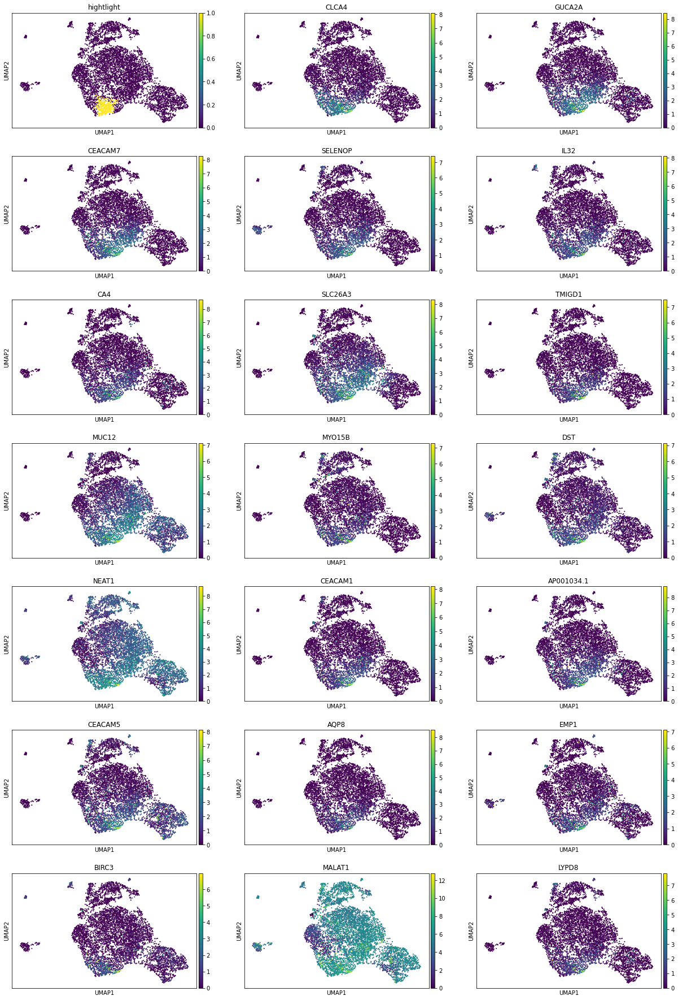

In [24]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


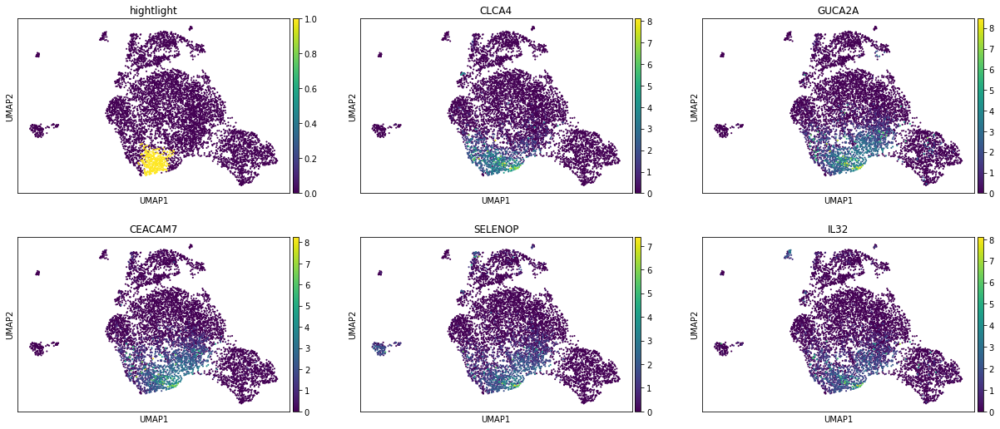

1


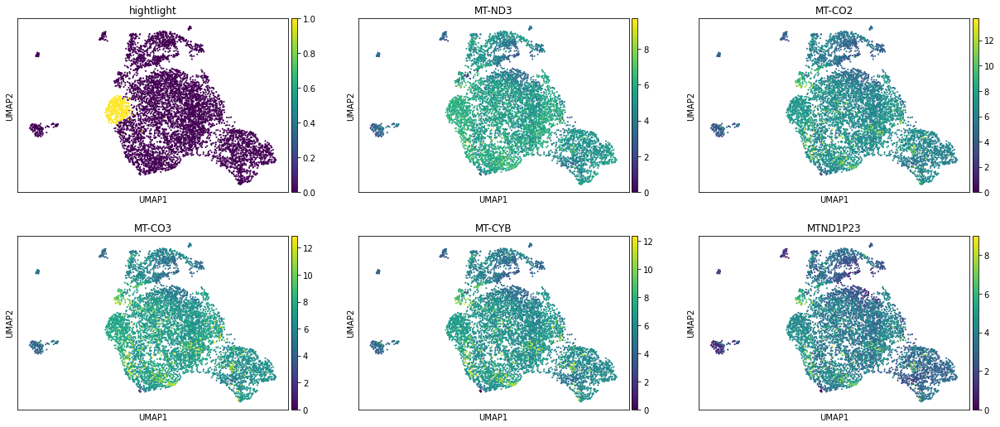

2


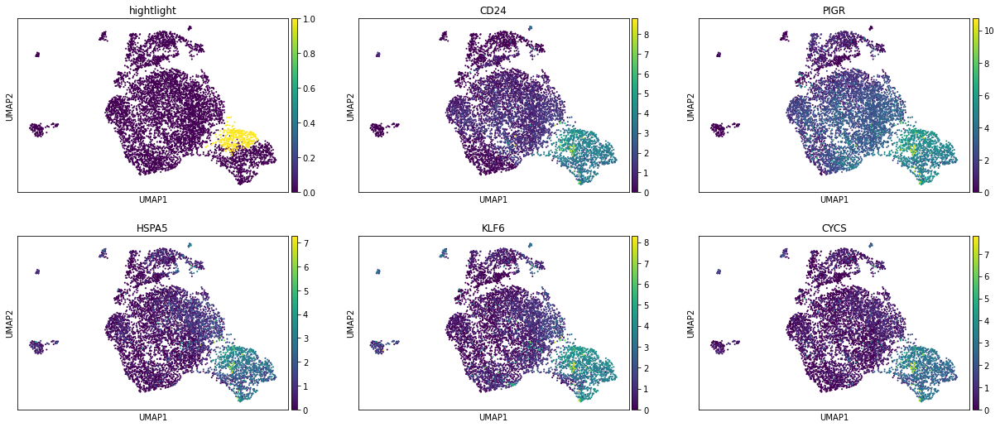

3


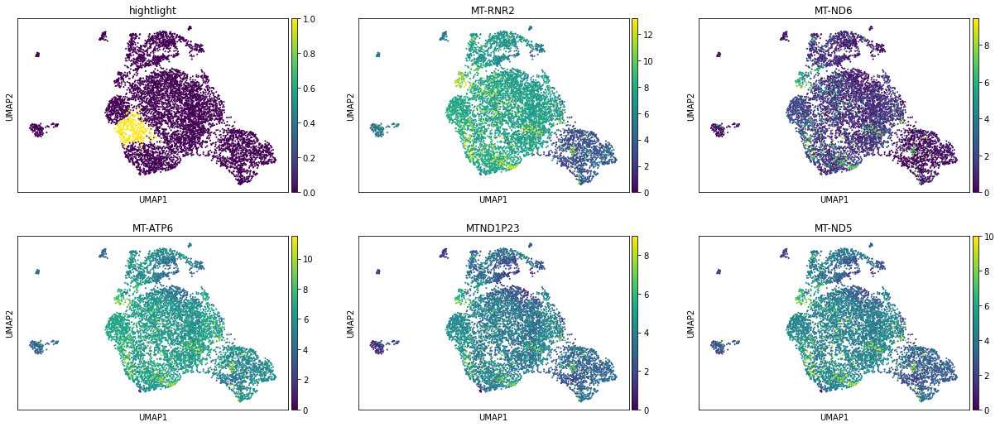

4


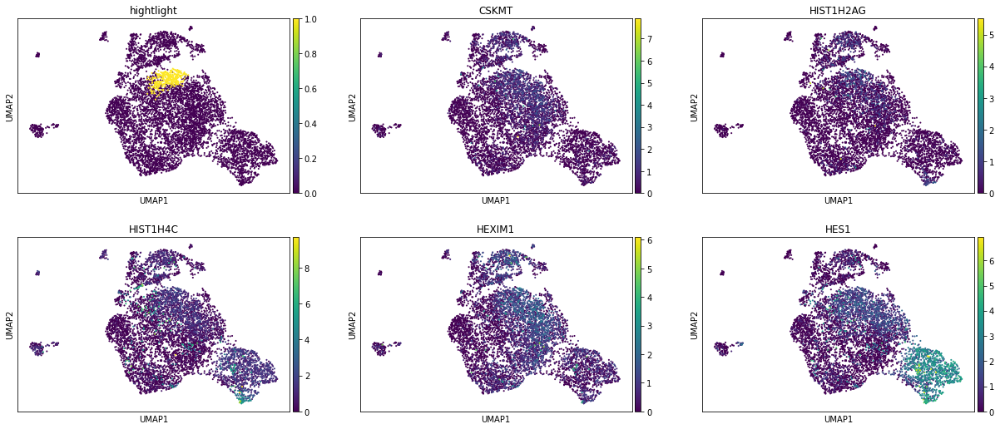

5


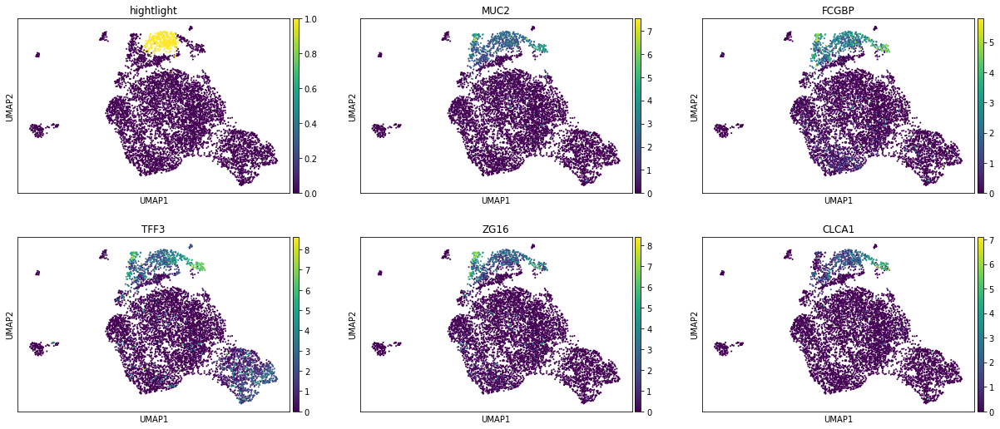

6


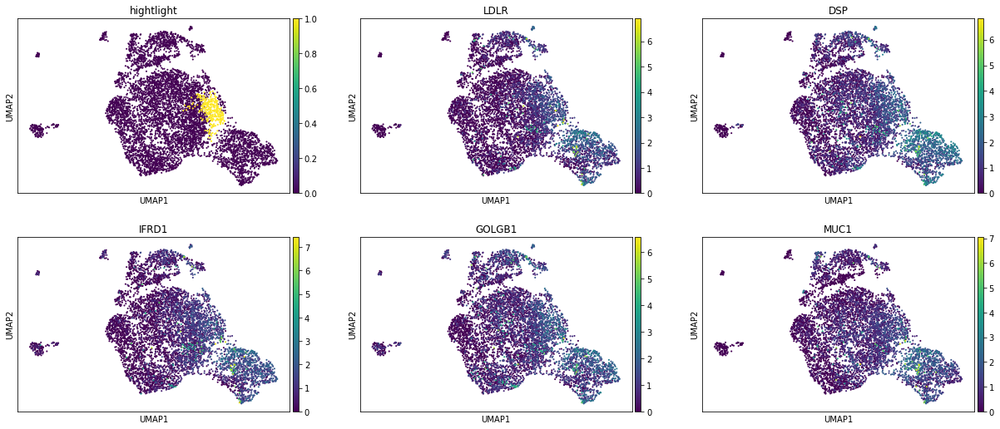

7


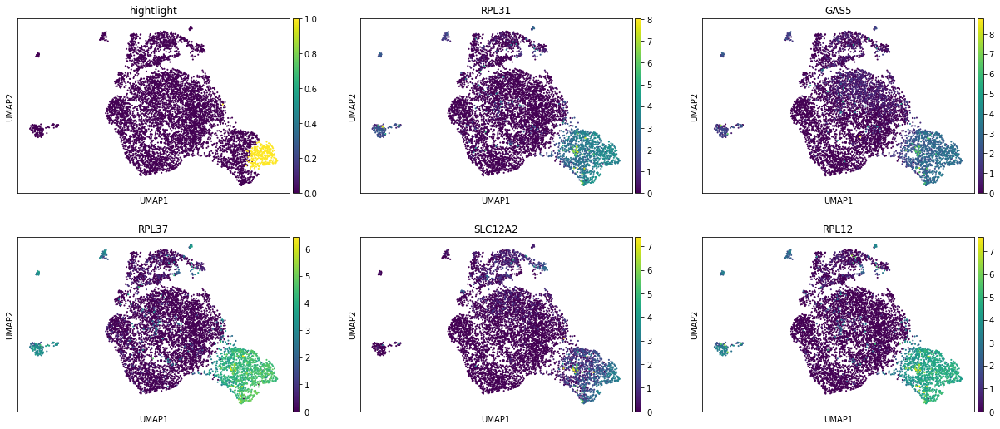

8


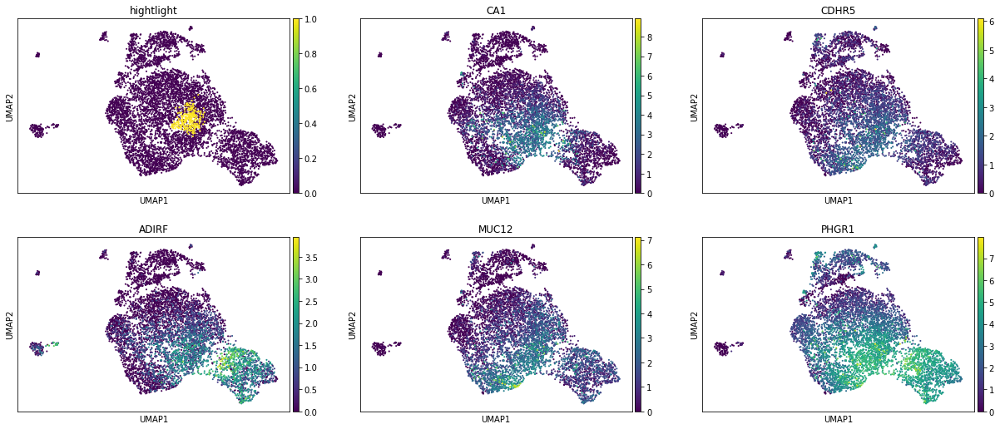

9


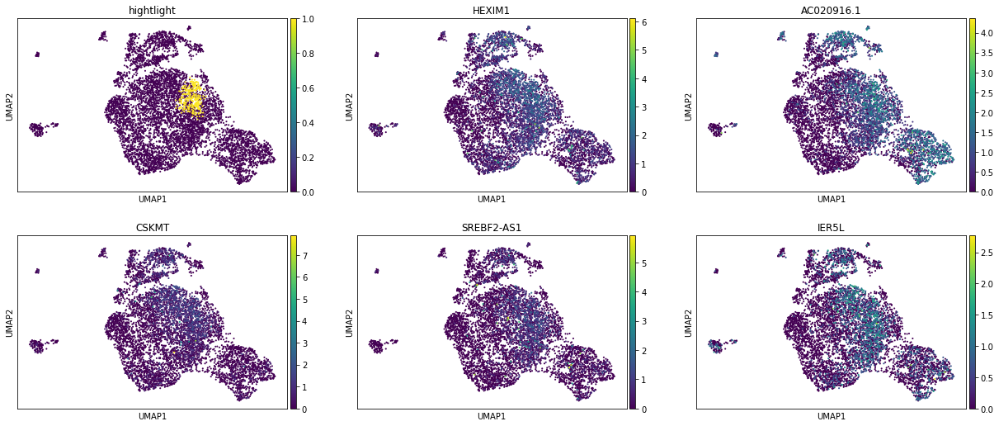

10


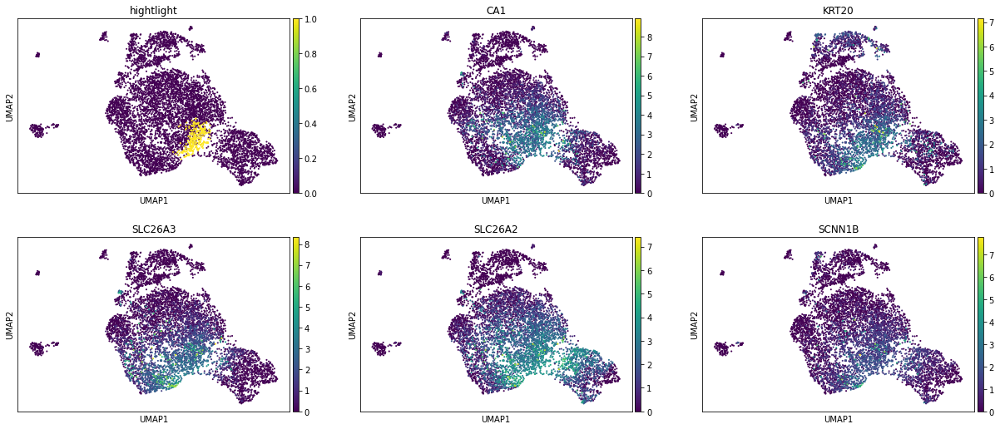

11


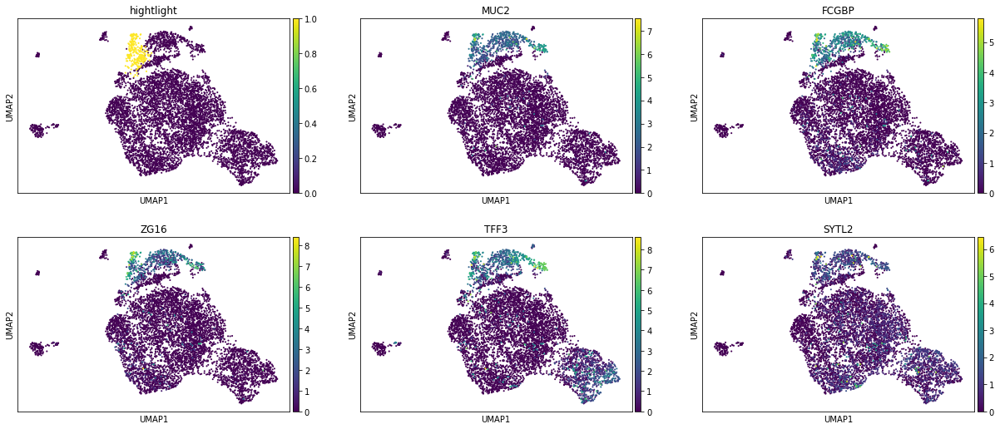

12


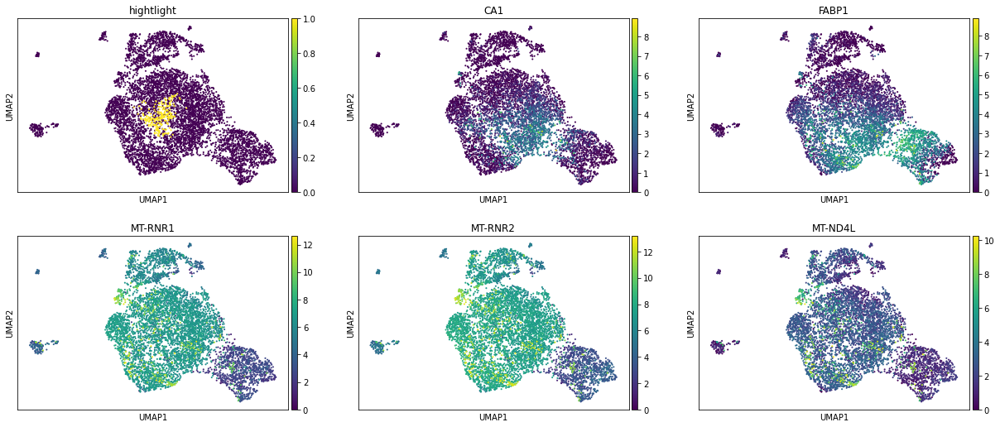

13


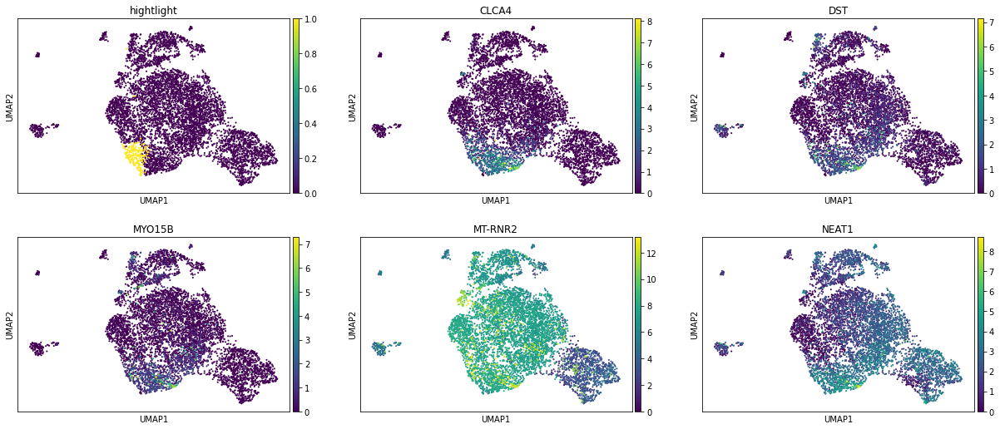

14


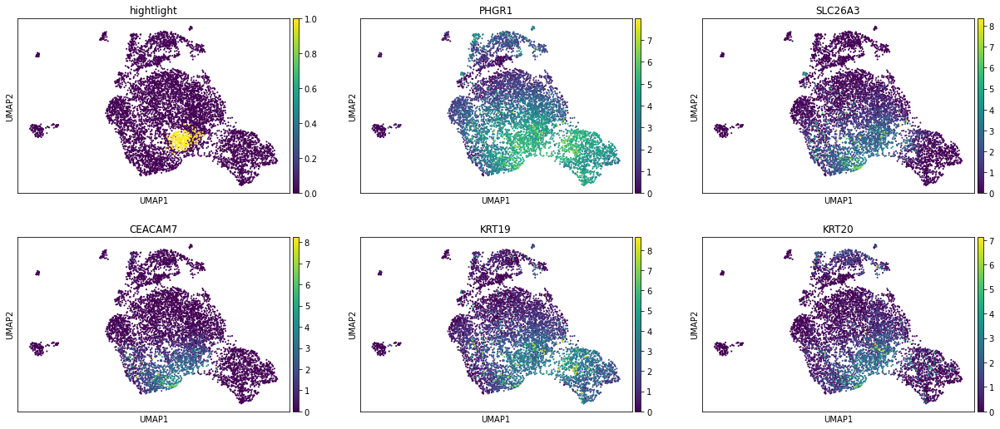

15


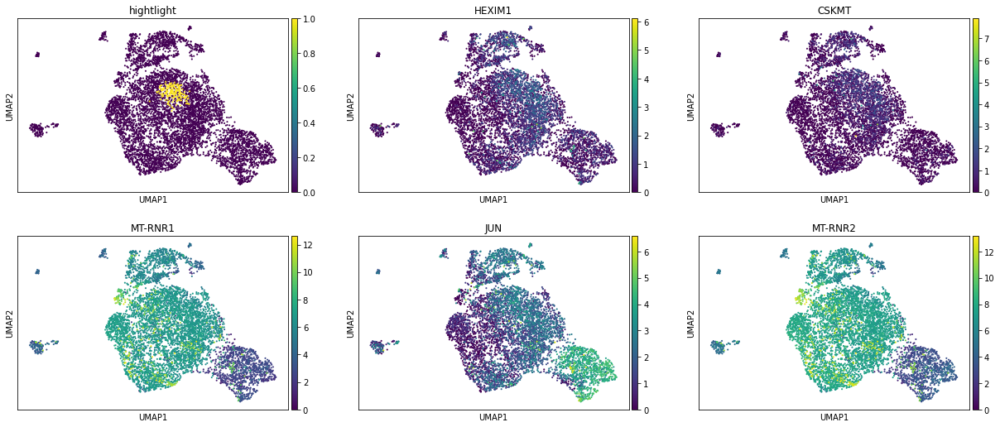

16


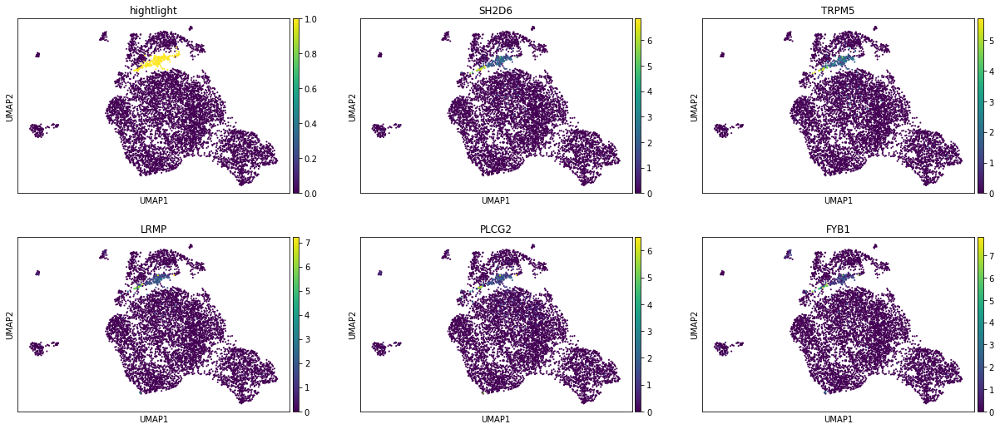

17


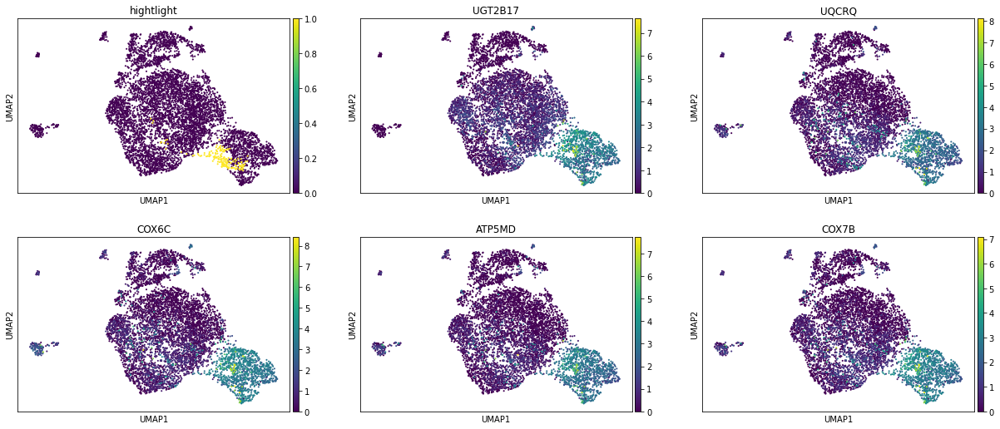

18


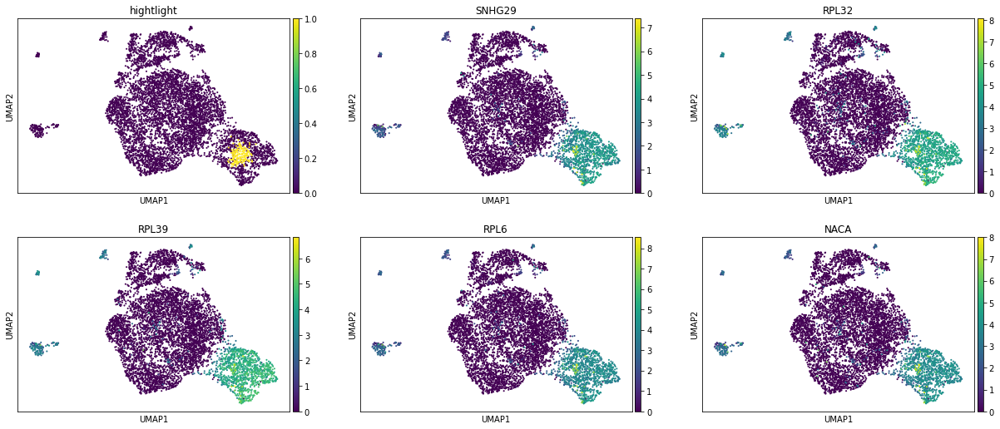

19


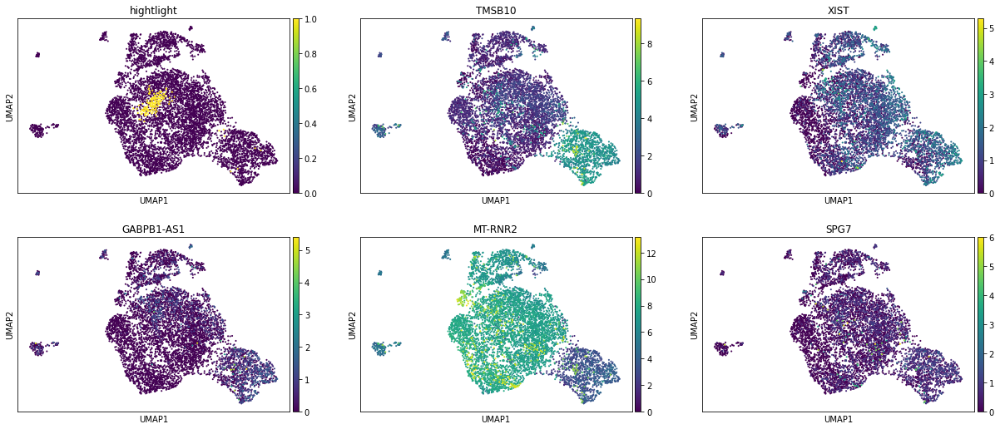

20


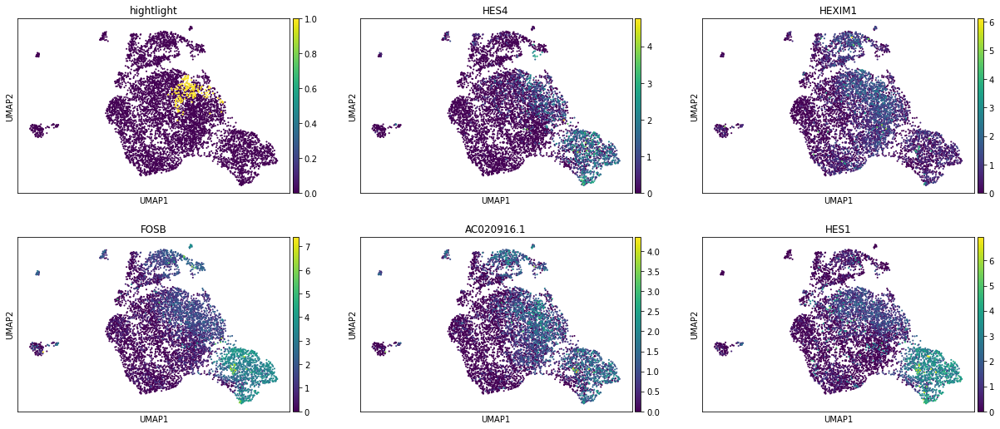

21


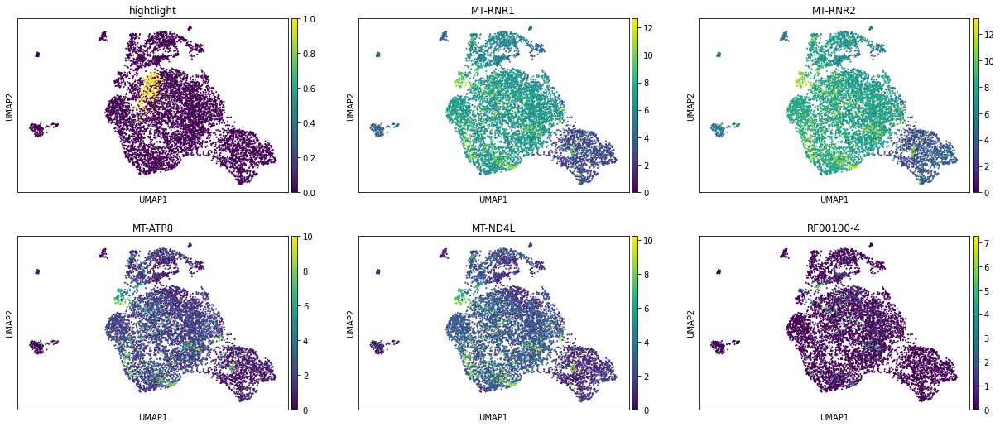

22


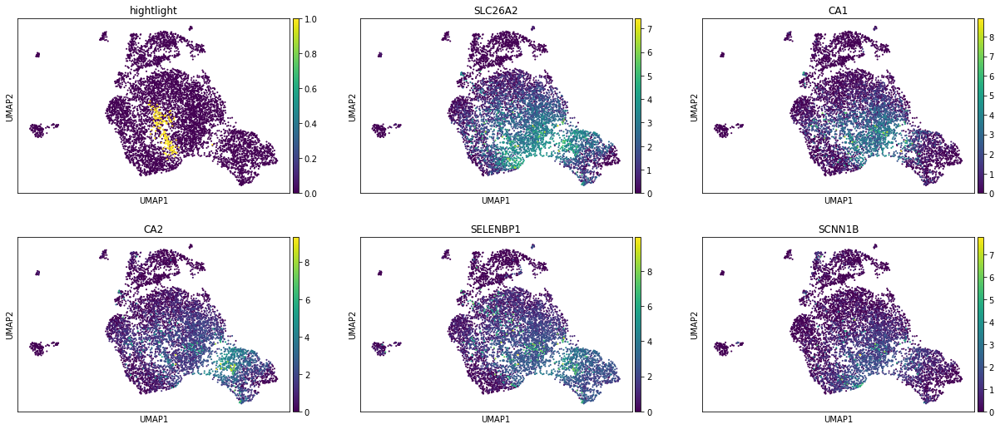

23


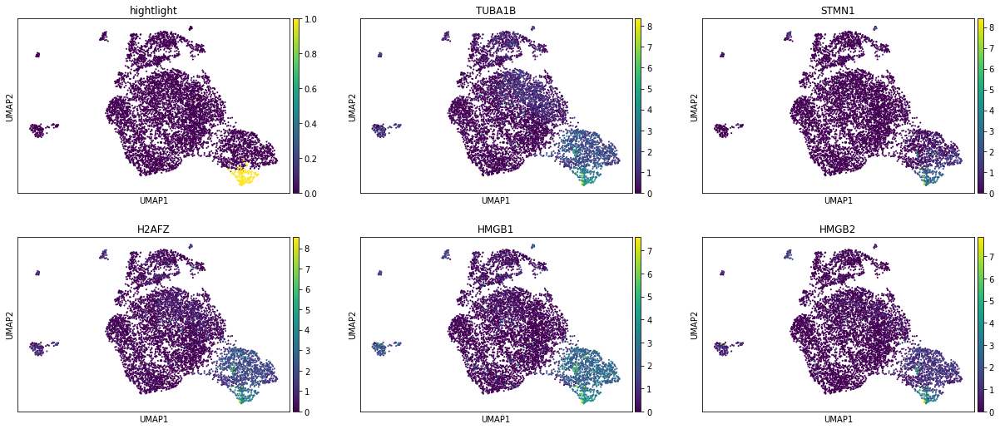

24


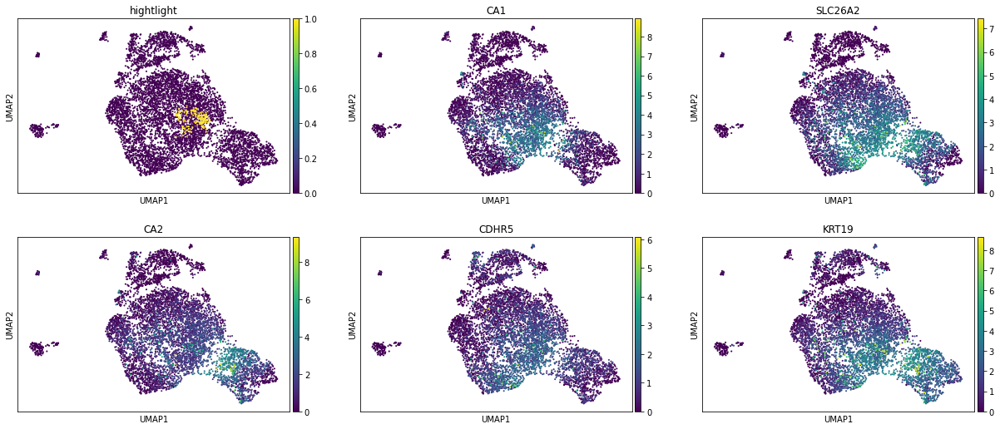

25


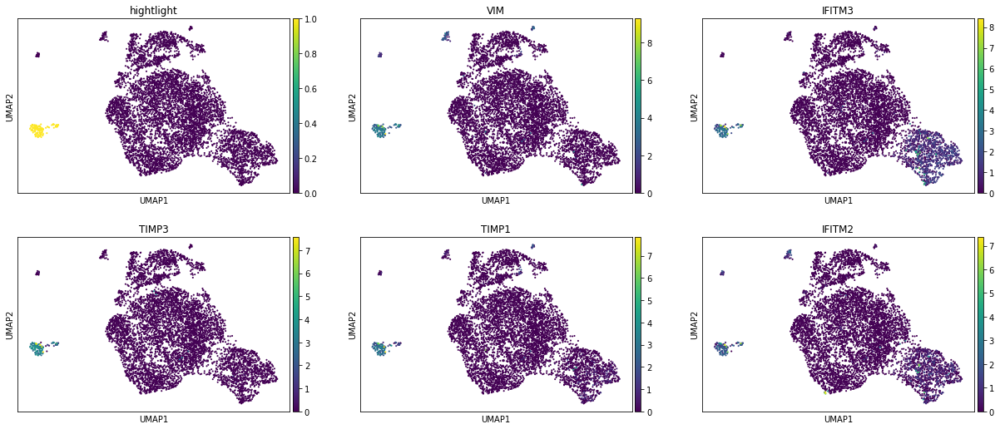

26


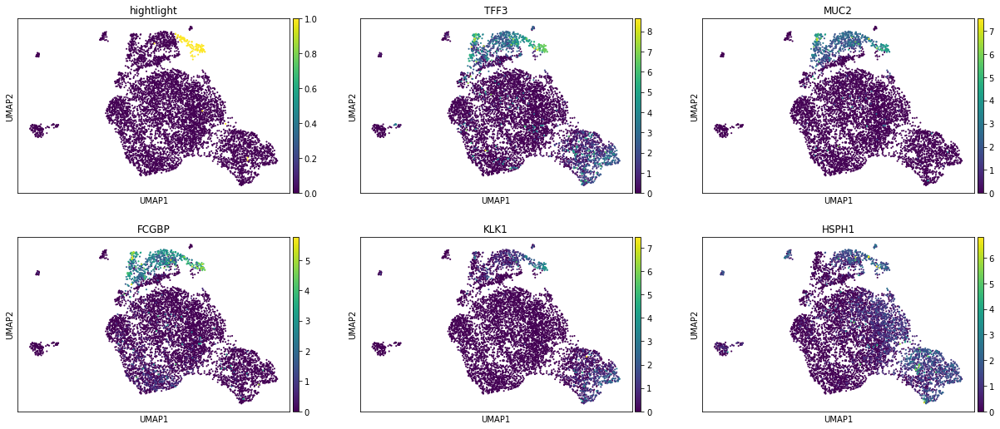

27


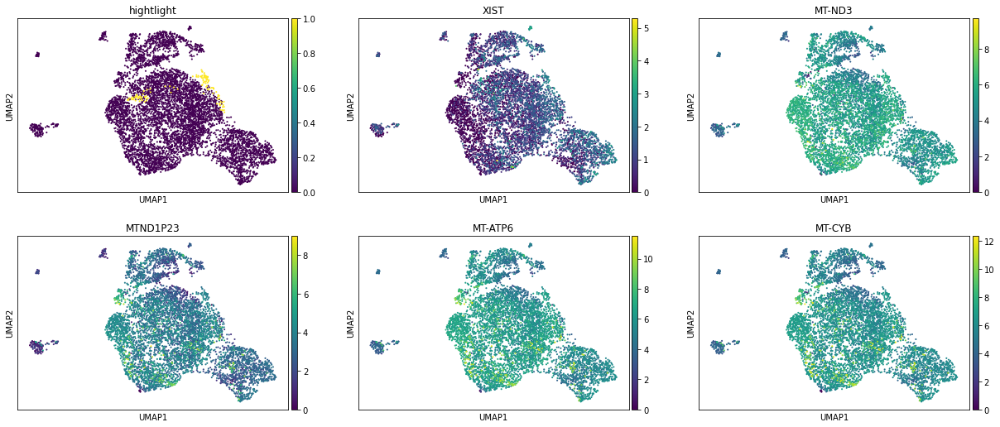

28


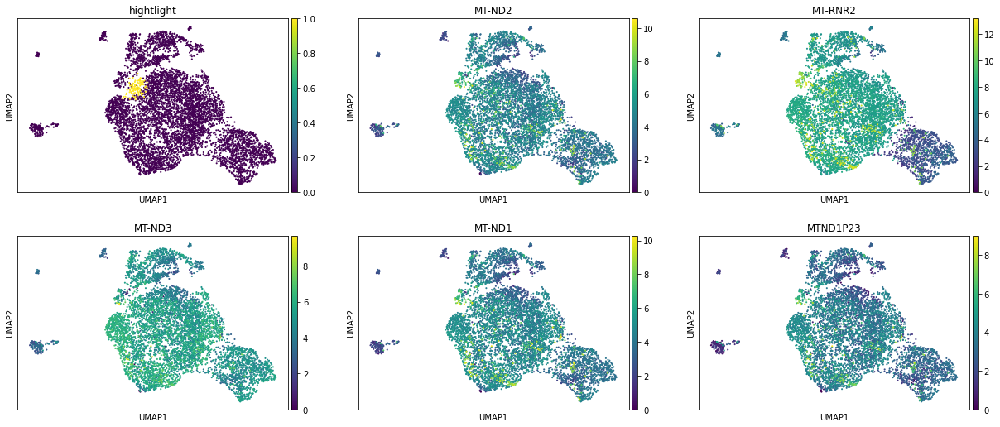

29


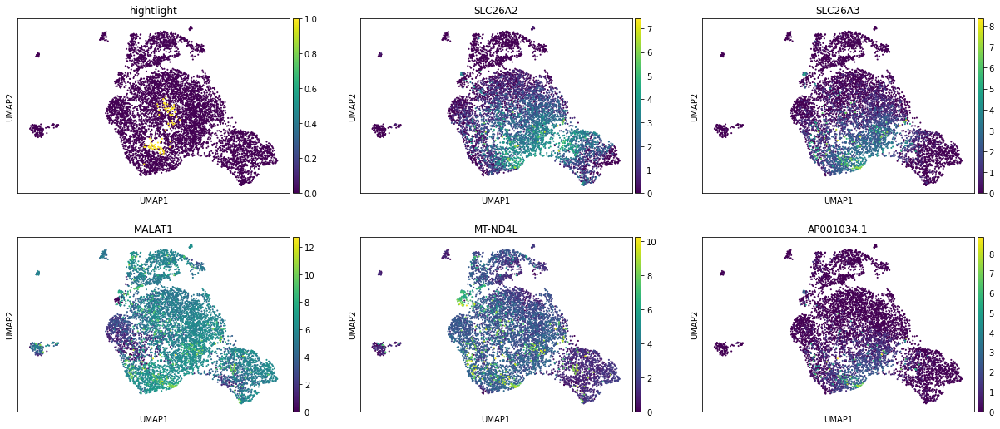

30


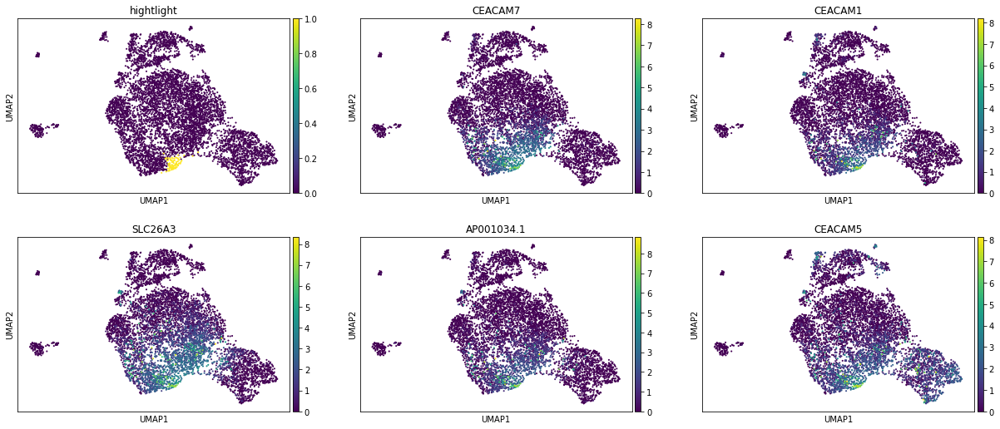

31


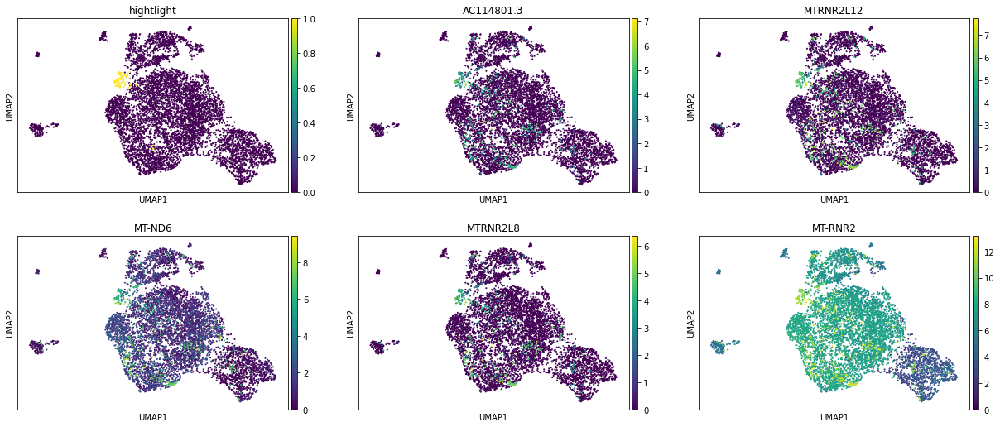

32


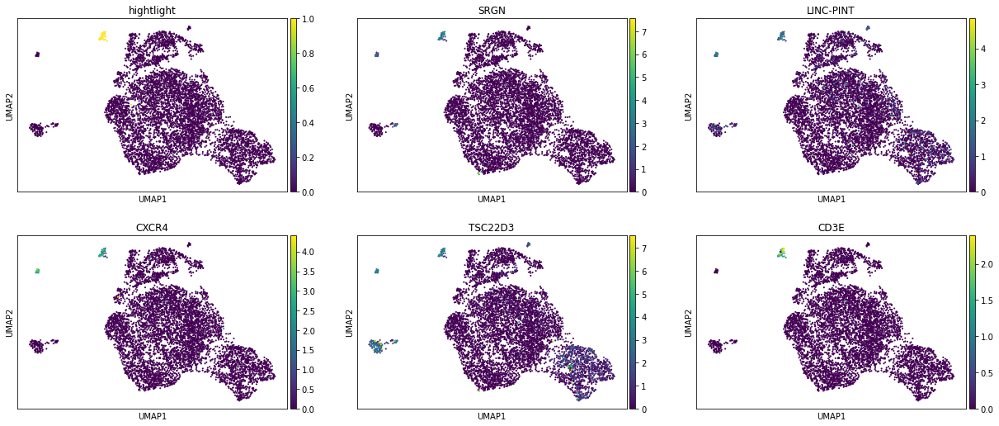

33


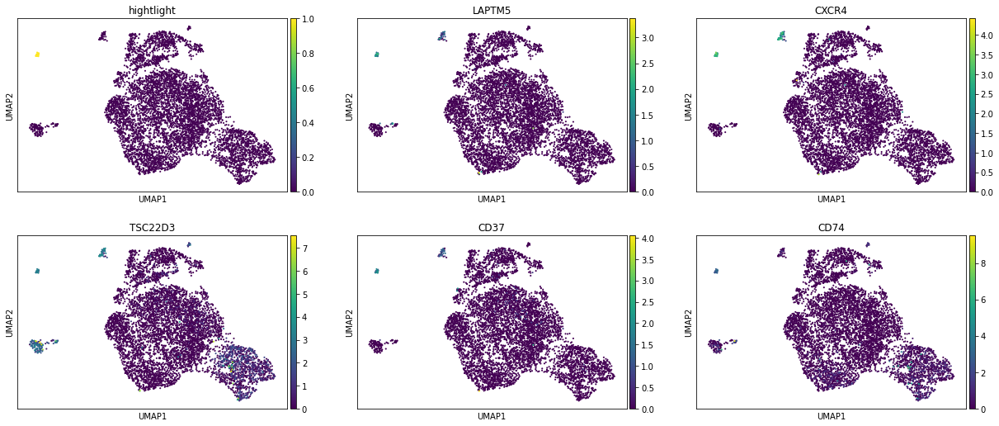

34


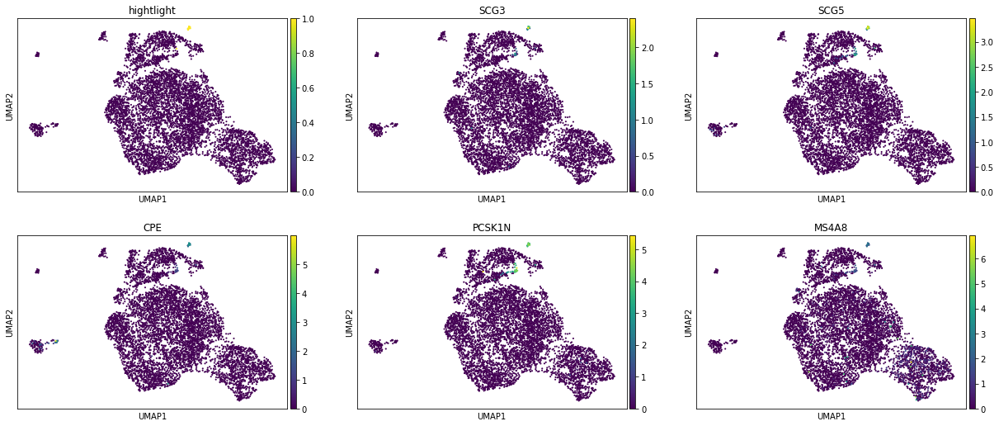

In [25]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [26]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
CLCA4,28.993553,5.909590,4.670614e-180
GUCA2A,27.530579,4.781933,2.225394e-162
CEACAM7,25.116819,4.037109,6.393121e-135
SELENOP,24.816887,3.575540,8.672602e-132
IL32,24.631992,3.810050,6.757882e-130
...,...,...,...
FOSB,-14.757627,-3.868688,4.256927e-46
HSP90AA1,-15.424505,-3.287432,1.939425e-50
RPL13,-15.973269,-8.609391,3.850645e-54
RPL28,-16.397453,-3.761592,4.348147e-57


# read in cell ontology 

In [27]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [28]:
celltype_dict['T cell']

'CL:0000084'

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [29]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-negative CD8-negative gamma-delta intraepithelial T cell',
 'CD4-negative, CD8-negative type I NK T cell secreting interferon-gamma',
 'CD69-positive, CD4-positive single-positive thymocyte',
 'effector memory CD4-positive, alpha-beta T cell',
 'CD4-positive, alpha-beta memory T cell',
 'effector CD4-positive, alpha-beta T cell',
 'CD24-positive, CD4 single-positive thymocyte',
 'CD4-positive type I NK T cell secreting interferon-gamma',
 'CD4-positive type I NK T cell secreting interleukin-4',
 'CD4-positive, alpha-beta T cell',
 'CD4-positive type I NK T cell',
 'CD4-negative, CD8-negative type I NK T cell',
 'CD2-positive, CD5-positive, CD44-positive alpha-beta intraepithelial T cell',
 'activated CD4-positive, CD25-positive, CCR4-positive, alpha-beta regulatory T cell, human',
 'CD4-negative, CD8-negative type I NK T cell secreting interleukin-4',
 'CD4-positive, alpha-beta intraepithelial T cell',
 'mature CD4 single-positive thymocyte',
 'CD4-positive, CXCR3-negative, CCR6-

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [30]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

This cell will automatically replace the leiden cluster names with cell type annotations

In [31]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,-0.410307,-0.117231,-0.205154,2.463199e+01
log fold change,-24.763018,-22.355286,-23.863691,3.810050e+00
adjusted pvalue,1.000000,1.000000,1.000000,6.757882e-130


# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



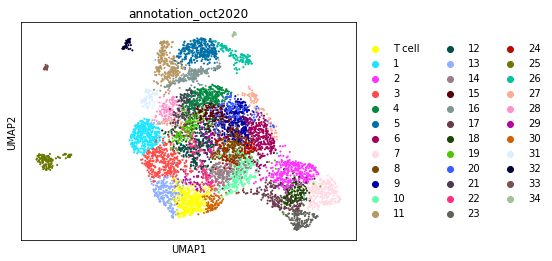

In [32]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# manually create mapping between cell type and compartment (this is just an example)

In [33]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

This cell will automatically replace the leiden cluster names with cell type annotations

In [34]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

# Visualize the results of the new compartment splitting

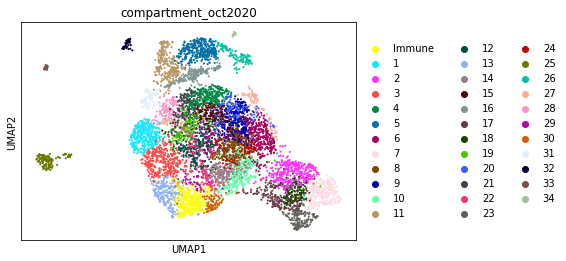

In [35]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [36]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)